In [1]:
using Plots, ColorSchemes, Statistics
Plots.default(fontfamily="Computer Modern")
include("src/HPMC.jl")

Main.HPMC

In [19]:
function plotsim(sim)
    modangle = 2π / sim.particles.sidenum
    colors = mod.(Array(sim.particles.angles), modangle) / modangle
    p1 = plot(sim.particles, colors, title="Orientation")

    colors = Array(abs.(sim.recorders[1].values[end]))
    p2 = plot(sim.particles, colors, ColorSchemes.vik, title="\$k\$-atic Order, \$k=4\$")

    colors = Array(abs.(sim.recorders[2].values[end]))
    p3 = plot(sim.particles, colors, ColorSchemes.vik, title="\$k\$-atic Order, \$k=6\$")

    colors = Array(abs.(sim.recorders[3].values[end]))
    p4 = plot(sim.particles, colors, ColorSchemes.vik, title="\$k\$-atic Order, \$k=8\$")

    p = plot!(p1, p2, p3, p4, layout=(2, 2), size=(500, 500))
    display(p)
end

function plotorders(sim)
    p1 = plot(sim.recorders[end].times, abs.(sim.recorders[end].values),
              ylabel="Mean Orientation")
    p2 = plot(sim.recorders[1].times,
              mean.([abs.(order) for order in sim.recorders[1].values]),
              ylabel="Mean \$k\$-atic Order, \$k=4\$")
    p3 = plot(sim.recorders[2].times,
              mean.([abs.(order) for order in sim.recorders[2].values]),
              ylabel="Mean \$k\$-atic Order, \$k=6\$")
    p4 = plot(sim.recorders[3].times,
              mean.([abs.(order) for order in sim.recorders[3].values]),
              ylabel="Mean \$k\$-atic Order, \$k=8\$")
    p = plot!(p1, p2, p3, p4, layout=(2, 2), legend=false,
              xlabel="t", color=:mediumblue, size=(800, 600))
    display(p)
end

plotorders (generic function with 1 method)

In [20]:
function plotsimdisk(sim, r, filepath)
    modangle = 2π / sim.particles.sidenum
    colors = mod.(Array(sim.particles.angles), modangle) / modangle
    θs = collect(0:0.01:2π)
    p1 = plot(sim.particles, colors, title="Orientation")
    plot!(p1, r * cos.(θs), r * sin.(θs), color=:black,
        alpha=0.5, seriestype=:shape)

    colors = Array(abs.(mean.(sim.recorders[1].values[end])))
    p2 = plot(sim.particles, colors, ColorSchemes.vik, title="\$k\$-atic Order, \$k=4\$")
    plot!(p2, r * cos.(θs), r * sin.(θs), color=:black,
        alpha=0.5, seriestype=:shape)

    colors = Array(abs.(mean.(sim.recorders[2].values[end])))
    p3 = plot(sim.particles, colors, ColorSchemes.vik, title="\$k\$-atic Order, \$k=6\$")
    plot!(p3, r * cos.(θs), r * sin.(θs), color=:black,
        alpha=0.5, seriestype=:shape)

    colors = Array(abs.(mean.(sim.recorders[3].values[end])))
    p4 = plot(sim.particles, colors, ColorSchemes.vik, title="\$k\$-atic Order, \$k=8\$")
    plot!(p4, r * cos.(θs), r * sin.(θs), color=:black,
        alpha=0.5, seriestype=:shape)

    p = plot!(p1, p2, p3, p4, layout=(2, 2), size=(500, 500))
    savefig(p, filepath)
    display(p)
end

plotsimdisk (generic function with 1 method)

In [21]:
n = 1024

1024

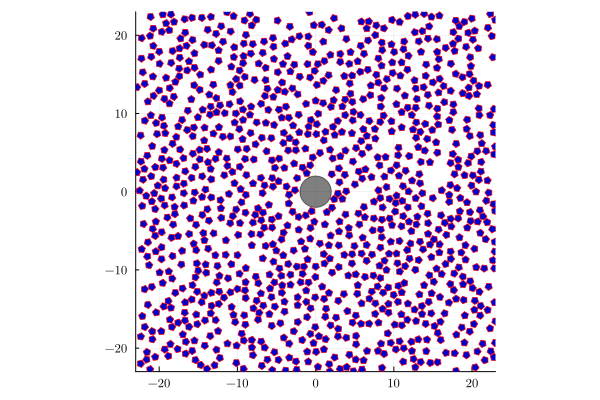

In [22]:
r = 2.0f0
sim = HPMC.HPMCSimulation(n, 5, 0.5, (ceil(√(2n)), ceil(√(2n))), gpu=true)
HPMC.crystallize!(sim.particles, ceil(Int, n + π * (r + sim.particles.radius)^2 / 2),
      (particles, centers) -> (sum((centers .- (0.0f0, 0.0f0)).^2, dims=1)
            .> (r + particles.radius) ^ 2))
sim.move_radius = 0.25
sim.rotation_span = π / 8
push!(sim.constraints, HPMC.DiskWall((0.0f0, 0.0f0), r, (x, y) -> ()))
HPMC.run!(sim, 5n)
p = plot(sim.particles)
θs = collect(0:0.01:2π)
plot!(p, r * cos.(θs), r * sin.(θs), color=:black,
      alpha=0.5, seriestype=:shape)

In [23]:
p_area = HPMC.particlearea(sim.particles)
initial_area_fraction = (HPMC.particlecount(sim.particles) * p_area
                         / HPMC.boxarea(sim.particles))

0.28765414481516927

In [24]:
final_area_fraction = 0.8
target_sidelen = Float32(√((HPMC.particlecount(sim.particles) * p_area
                            + π * r^2) / final_area_fraction))

27.866703f0

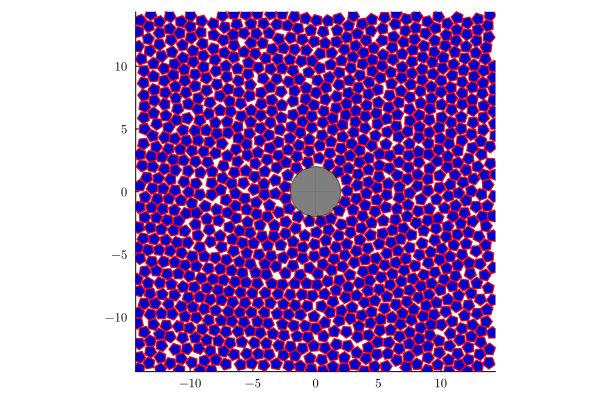

In [25]:
push!(sim.updaters, HPMC.MoveSizeTuner(
    t -> t % 10 == 0, 0.5; max_move_radius=0.25, max_rotation_span=π/8))
push!(sim.updaters, HPMC.ForcefulCompressor(
    t -> t % 20 == 0, (target_sidelen, target_sidelen)))
push!(sim.recorders, HPMC.LocalParamRecorder(
    t -> t % (n ÷ 20) == 0, "katic", 4))
push!(sim.recorders, HPMC.LocalParamRecorder(
    t -> t % (n ÷ 20) == 0, "katic", 6))
push!(sim.recorders, HPMC.LocalParamRecorder(
    t -> t % (n ÷ 20) == 0, "katic", 8))
push!(sim.recorders, HPMC.GlobalParamRecorder(
    t -> t % (n ÷ 20) == 0, "orient"))
HPMC.run!(sim, 40n)
p = plot(sim.particles, ratio=:equal)
θs = collect(0:0.01:2π)
plot!(p, r * cos.(θs), r * sin.(θs), color=:black,
      alpha=0.5, seriestype=:shape)
display(p)

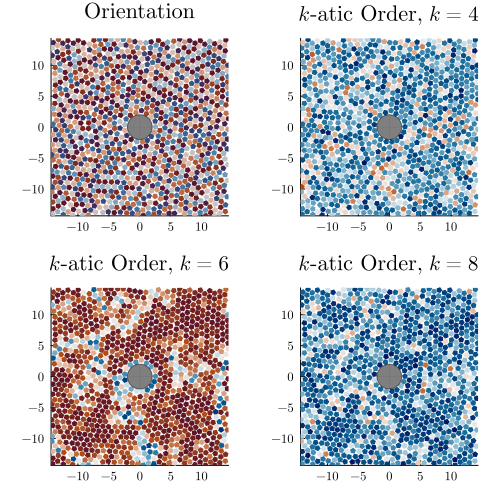

In [26]:
plotsimdisk(sim, r, "pentagon.pdf")

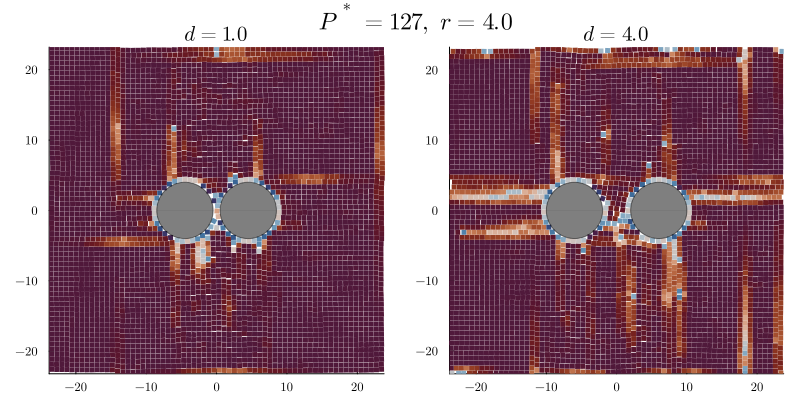

In [18]:
filepath = "data/4gon4.0r1.0d127.0p.jld2"
particles = HPMC.RegularPolygons(
    HPMC.RegularPolygonsSnapshot(filepath, HPMC.framecount(filepath)), gpu=true)
p1 = plot(particles, abs.(HPMC.katic_order(particles, 4)), title="\$d=1.0\$")
θs = collect(0:0.01:2π)
plot!(p1, 4.0 * cos.(θs) .+ 4.5, 4.0 * sin.(θs), color=:black,
    alpha=0.5, seriestype=:shape)
plot!(p1, 4.0 * cos.(θs) .- 4.5, 4.0 * sin.(θs), color=:black,
    alpha=0.5, seriestype=:shape)

filepath = "data/4gon4.0r4.0d127.0p.jld2"
particles = HPMC.Regfilepath = "data/4gon4.0r1.0d127.0p.jld2"
particles = HPMC.RegularPolygons(
    HPMC.RegularPolygonsSnapshot(filepath, HPMC.framecount(filepath)), gpu=true)
p1 = plot(particles, abs.(HPMC.katic_order(particles, 4)), title="\$d=1.0\$")
θs = collect(0:0.01:2π)
plot!(p1, 4.0 * cos.(θs) .+ 4.5, 4.0 * sin.(θs), color=:black,
    alpha=0.5, seriestype=:shape)
plot!(p1, 4.0 * cos.(θs) .- 4.5, 4.0 * sin.(θs), color=:black,
    alpha=0.5, seriestype=:shape)

filepath = "data/4gon4.0r4.0d127.0p.jld2"
particles = HPMC.RegularPolygons(
    HPMC.RegularPolygonsSnapshot(filepath, HPMC.framecount(filepath)))
p2 = plot(particles, abs.(HPMC.katic_order(particles, 4)), title="\$d=4.0\$")
θs = collect(0:0.01:2π)
plot!(p2, 4.0 * cos.(θs) .+ 6.0, 4.0 * sin.(θs), color=:black,
    alpha=0.5, seriestype=:shape)
plot!(p2, 4.0 * cos.(θs) .- 6.0, 4.0 * sin.(θs), color=:black,
    alpha=0.5, seriestype=:shape)

p = plot(p1, p2, layout=(1, 2), plot_title="\$P^*=127,\\ r=4.0\$", size=(800, 400))
savefig(p, "doubledisk.pdf")
display(p)ularPolygons(
    HPMC.RegularPolygonsSnapshot(filepath, HPMC.framecount(filepath)))
p2 = plot(particles, abs.(HPMC.katic_order(particles, 4)), title="\$d=4.0\$")
θs = collect(0:0.01:2π)
plot!(p2, 4.0 * cos.(θs) .+ 6.0, 4.0 * sin.(θs), color=:black,
    alpha=0.5, seriestype=:shape)
plot!(p2, 4.0 * cos.(θs) .- 6.0, 4.0 * sin.(θs), color=:black,
    alpha=0.5, seriestype=:shape)

p = plot(p1, p2, layout=(1, 2), plot_title="\$P^*=127,\\ r=4.0\$", size=(800, 400))
savefig(p, "doubledisk.pdf")
display(p)

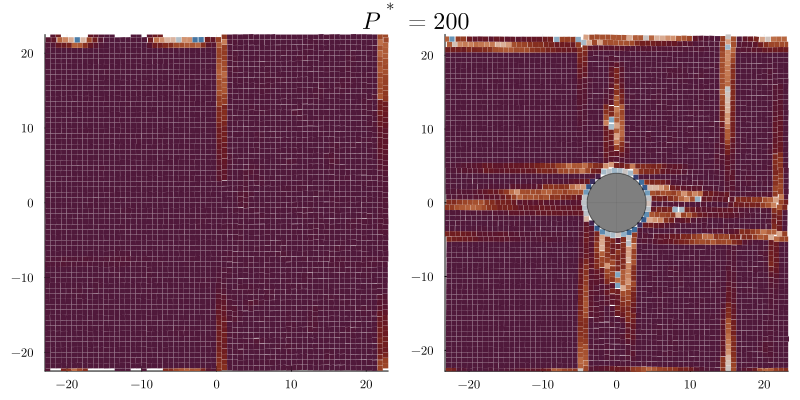

In [17]:
filepath = "data/4gon200.0p.jld2"
particles = HPMC.RegularPolygons(
    HPMC.RegularPolygonsSnapshot(filepath, HPMC.framecount(filepath)), gpu=true)
p1 = plot(particles, abs.(HPMC.katic_order(particles, 4)))

filepath = "data/4gon4.0r200.0p.jld2"
particles = HPMC.RegularPolygons(
    HPMC.RegularPolygonsSnapshot(filepath, HPMC.framecount(filepath)))
p2 = plot(particles, abs.(HPMC.katic_order(particles, 4)))
θs = collect(0:0.01:2π)
plot!(p2, 4.0 * cos.(θs), 4.0 * sin.(θs), color=:black,
    alpha=0.5, seriestype=:shape)

p = plot(p1, p2, layout=(1, 2), plot_title="\$P^*=200\$", size=(800, 400))
savefig(p, "compare.pdf")
display(p)

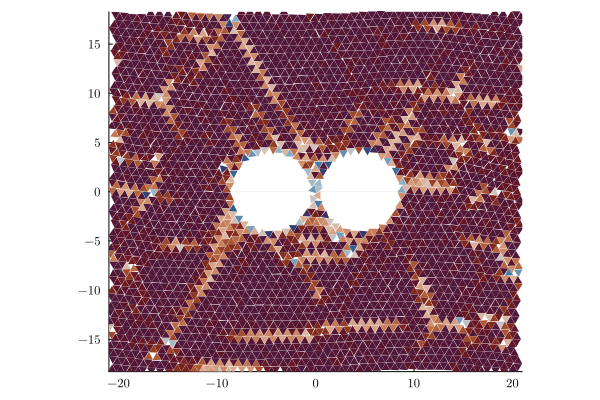

In [5]:
filepath = "data/raw/3gon4.0r1.0d100.0p1.jld2"
particles = HPMC.RegularPolygons(
    HPMC.RegularPolygonsSnapshot(filepath, HPMC.framecount(filepath)), gpu=true)
plot(particles, abs.(HPMC.katic_order(particles, 3)))